<a href="https://colab.research.google.com/github/jomacuesta/ScriptsPython/blob/main/P1_MachineLearning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#PRÁCTICA 1 - 07MBID - MACHINE LEARNING
####DengAI : Predicting Disease Spread
[enlace](https://www.drivendata.org/competitions/44/dengai-predicting-disease-spread/)


#OBJETIVO DE LA PRACTICA

En la presente práctica, se realizará un análisis exploratorio del Dataset previamente adjunto con el enlace.

Esta práctica supondrá un gran avance para la segunda práctica donde buscaremos generar un modelo de machine learning supervisado capaz de predecir los casos de dengue en función de las características climatológicas/geográficas. 

Por este motivo, profundizaremos en la medida de lo posible en la fase de preprocesado para la mejor selección de características probando varios enfoques y realizando varios tipos de clusterización.

#CARGA DE DATOS

In [577]:
## IMPORTACION DE LIBRERIAS NECESARIAS
# carga de datos
import pandas as pd
import io
from google.colab import files
# manipulación y visualización
import matplotlib.pyplot as plt
import numpy as np
import itertools
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler


In [578]:
#Tomamos archivo
train = pd.read_csv("/content/dengue_features_train.csv", index_col = ['city', 'weekofyear', 'year'])


In [579]:
train.head(20)

week_start_date  ...  station_precip_mm
city weekofyear year                  ...                   
sj   18         1990      1990-04-30  ...               16.0
     19         1990      1990-05-07  ...                8.6
     20         1990      1990-05-14  ...               41.4
     21         1990      1990-05-21  ...                4.0
     22         1990      1990-05-28  ...                5.8
     23         1990      1990-06-04  ...               39.1
     24         1990      1990-06-11  ...               29.7
     25         1990      1990-06-18  ...               21.1
     26         1990      1990-06-25  ...               21.1
     27         1990      1990-07-02  ...                1.1
     28         1990      1990-07-09  ...               63.7
     29         1990      1990-07-16  ...               12.2
     30         1990      1990-07-23  ...               32.6
     31         1990      1990-07-30  ...               37.6
     32         1990      1990-08-06  ...               11.4
     33         1990      1990-08-13  ...               44.7
     34         1990      1990-08-20  ...                5.4
     35         1990      1990-08-27  ...               13.7
     36         1990      1990-09-03  ...               14.2
     37         1990      1990-09-10  ...               25.9

[20 rows x 21 columns]

#INSPECCIÓN GENERAL DEL DATASET

In [580]:
#Analizamos tamaño del dataset
print("El numero de filas es:{tam}".format(tam=len(train)))


El numero de filas es:1456


In [581]:
#Analizamos tipologia de la columnas
train.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 1456 entries, ('sj', 18, 1990) to ('iq', 25, 2010)
Data columns (total 21 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   week_start_date                        1456 non-null   object 
 1   ndvi_ne                                1262 non-null   float64
 2   ndvi_nw                                1404 non-null   float64
 3   ndvi_se                                1434 non-null   float64
 4   ndvi_sw                                1434 non-null   float64
 5   precipitation_amt_mm                   1443 non-null   float64
 6   reanalysis_air_temp_k                  1446 non-null   float64
 7   reanalysis_avg_temp_k                  1446 non-null   float64
 8   reanalysis_dew_point_temp_k            1446 non-null   float64
 9   reanalysis_max_air_temp_k              1446 non-null   float64
 10  reanalysis_min_air_temp_k              1446 n

De los resultados anteriores, podemos concluir que nuestro dataset posee 1456 registros con 21 columnas

In [582]:
train.shape

(1456, 21)

In [583]:
#Analizamos la cantidad de valores nulos - Generamos los valores en %
(train.isnull().sum()/1461)*100


week_start_date                           0.000000
ndvi_ne                                  13.278576
ndvi_nw                                   3.559206
ndvi_se                                   1.505818
ndvi_sw                                   1.505818
precipitation_amt_mm                      0.889802
reanalysis_air_temp_k                     0.684463
reanalysis_avg_temp_k                     0.684463
reanalysis_dew_point_temp_k               0.684463
reanalysis_max_air_temp_k                 0.684463
reanalysis_min_air_temp_k                 0.684463
reanalysis_precip_amt_kg_per_m2           0.684463
reanalysis_relative_humidity_percent      0.684463
reanalysis_sat_precip_amt_mm              0.889802
reanalysis_specific_humidity_g_per_kg     0.684463
reanalysis_tdtr_k                         0.684463
station_avg_temp_c                        2.943190
station_diur_temp_rng_c                   2.943190
station_max_temp_c                        1.368925
station_min_temp_c             

Observamos que existe una columna que no es de tipo numérico que hace referencia al día en el que comienza la semana marcada en el index. Esta columna será eliminada en la fase de preprocesado ya que es una información de detalle excesiva y altamente correlacionada con la semana.

In [584]:
train.index.get_level_values(0).value_counts()

sj    936
iq    520
Name: city, dtype: int64

Observamos que el dataset se encuentra ligeramente desbalanceado ya que existe casi el doble de registros de una región que de la otra (*1.8 veces). Esto podría dar lugar a ciertos problemas, como por ejemplo en la consideración de outliers, ya que la categoría o región mayoritaria puede hacer que casi todas las muestras de la minoritaria parezcan outliers entre otros problemas.

Dado que el dataset no es muy grande, evitaremos el submuestreo y realizaremos un sobremuestreo.

En esta primera práctica, como el objetivo es una clusterización o agrupación de los datos, no tiene mucho sentido duplicar los datos. Por este motivo, tomaremos 200 muestras aleatorias de la región minoritaria y aplicaremos un cambio de 1% para que no sean exactamente las mismas muestras.

Este tratamiento se realizará en el apartado de preprocesamiento.

#PREPROCESADO DE LOS DATOS





Dado que nuestro DataSet no presenta un gran tamaño, no eliminaremos los registros que presentan algún valor nulo y realizaremos el método ffill para rellenar con el anterior.

## Data Cleaning - Correlacion

In [585]:
train.drop("week_start_date", axis = 1, inplace = True)
train.head()

ndvi_ne   ndvi_nw  ...  station_min_temp_c  station_precip_mm
city weekofyear year                      ...                                       
sj   18         1990  0.122600  0.103725  ...                20.0               16.0
     19         1990  0.169900  0.142175  ...                22.2                8.6
     20         1990  0.032250  0.172967  ...                22.8               41.4
     21         1990  0.128633  0.245067  ...                23.3                4.0
     22         1990  0.196200  0.262200  ...                23.9                5.8

[5 rows x 20 columns]

Para manejar los valores nulos, empleamos el método ffill (forward)

In [586]:
# ffill: Propagando los valores anteriores al siguiente
train.fillna(method='ffill', inplace=True)
pd.isnull(train).any()

ndvi_ne                                  False
ndvi_nw                                  False
ndvi_se                                  False
ndvi_sw                                  False
precipitation_amt_mm                     False
reanalysis_air_temp_k                    False
reanalysis_avg_temp_k                    False
reanalysis_dew_point_temp_k              False
reanalysis_max_air_temp_k                False
reanalysis_min_air_temp_k                False
reanalysis_precip_amt_kg_per_m2          False
reanalysis_relative_humidity_percent     False
reanalysis_sat_precip_amt_mm             False
reanalysis_specific_humidity_g_per_kg    False
reanalysis_tdtr_k                        False
station_avg_temp_c                       False
station_diur_temp_rng_c                  False
station_max_temp_c                       False
station_min_temp_c                       False
station_precip_mm                        False
dtype: bool

Text(0.5, 1.0, 'Correlacion de variables')

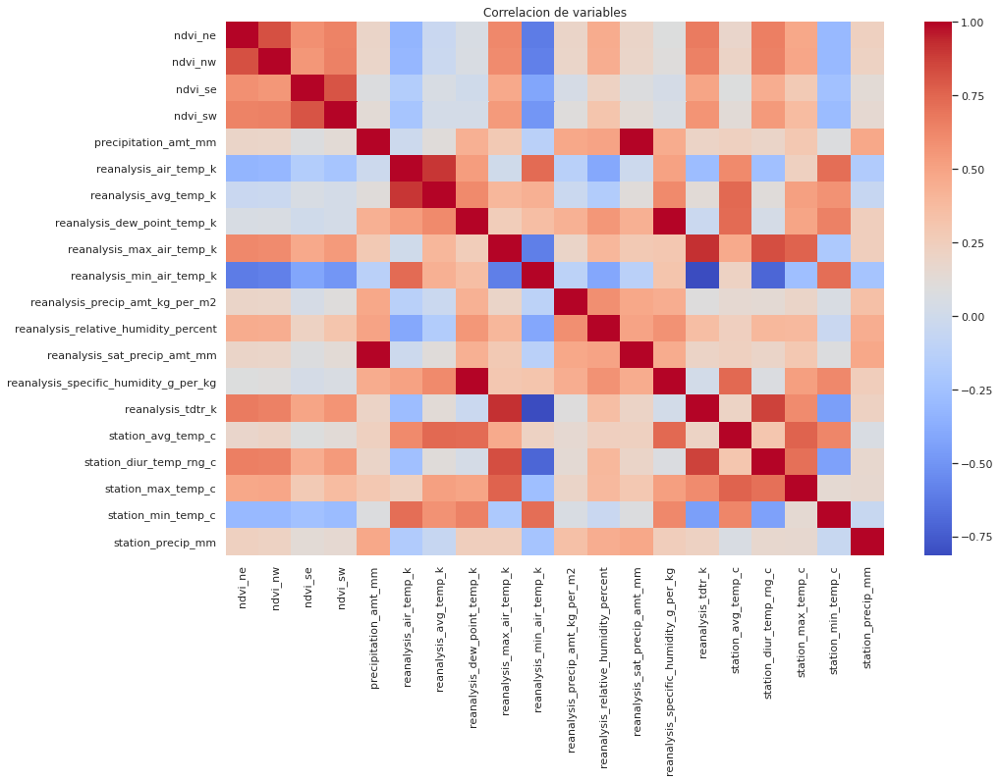

In [587]:
#Estudiamos la correlación de las variables
corr = train.corr()
fig_dims = (15, 10)
fig, ax = plt.subplots(figsize=fig_dims)
sns.heatmap(corr,cmap='coolwarm',ax=ax)
plt.title('Correlacion de variables')

In [588]:
print(type(corr))

<class 'pandas.core.frame.DataFrame'>


In [589]:
corr

,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,reanalysis_avg_temp_k,reanalysis_dew_point_temp_k,reanalysis_max_air_temp_k,reanalysis_min_air_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
ndvi_ne,1.000000,0.824107,0.586109,0.645100,0.195393,-0.331672,-0.038252,0.054772,0.621991,-0.612693,0.193194,0.456352,0.195393,0.091533,0.667052,0.183278,0.657629,0.477253,-0.301203,0.228976
ndvi_nw,0.824107,1.000000,0.554892,0.651769,0.188579,-0.317921,-0.032159,0.064057,0.606766,-0.589707,0.189160,0.451413,0.188579,0.101519,0.646759,0.199266,0.649027,0.482731,-0.300013,0.213167
ndvi_se,0.586109,0.554892,1.000000,0.814252,0.083593,-0.159185,0.051295,0.005600,0.470299,-0.411121,0.037521,0.219981,0.083593,0.032210,0.489896,0.089394,0.449198,0.283555,-0.251023,0.131235
ndvi_sw,0.645100,0.651769,0.814252,1.000000,0.128330,-0.225483,0.024299,0.024638,0.545422,-0.492442,0.103944,0.312778,0.128330,0.057477,0.568326,0.124406,0.544537,0.374184,-0.288346,0.156191
precipitation_amt_mm,0.195393,0.188579,0.083593,0.128330,1.000000,-0.015362,0.109151,0.437603,0.285011,-0.120072,0.481093,0.501431,1.000000,0.454162,0.203493,0.230343,0.192150,0.294615,0.080959,0.481349
reanalysis_air_temp_k,-0.331672,-0.317921,-0.159185,-0.225483,-0.015362,1.000000,0.901969,0.528840,0.001759,0.735368,-0.128928,-0.402466,-0.015362,0.507362,-0.277196,0.611060,-0.257840,0.232696,0.717484,-0.173951
reanalysis_avg_temp_k,-0.038252,-0.032159,0.051295,0.024299,0.109151,0.901969,1.000000,0.614025,0.400625,0.435215,-0.032077,-0.168282,0.109151,0.612167,0.127127,0.742202,0.108604,0.514923,0.578646,-0.050696
reanalysis_dew_point_temp_k,0.054772,0.064057,0.005600,0.024638,0.437603,0.528840,0.614025,1.000000,0.259867,0.360190,0.432638,0.554573,0.437603,0.997045,-0.030395,0.736519,0.034479,0.492950,0.650818,0.241597
reanalysis_max_air_temp_k,0.621991,0.606766,0.470299,0.545422,0.285011,0.001759,0.400625,0.259867,1.000000,-0.600087,0.192781,0.399407,0.285011,0.302732,0.918764,0.462610,0.831306,0.761366,-0.191322,0.243221
reanalysis_min_air_temp_k,-0.612693,-0.589707,-0.411121,-0.492442,-0.120072,0.735368,0.435215,0.360190,-0.600087,1.000000,-0.106848,-0.410417,-0.120072,0.316888,-0.814772,0.213197,-0.704923,-0.264625,0.718904,-0.231817


In [590]:
#Creo función para pintar las celdas con valor mayor al 70% de correlación (0.7)
def text_format(val):
    if val > 0.69 :
      color = 'salmon' 
    else:
      color = 'white'
    return 'background-color: %s' % color


In [591]:
df = corr.style.applymap(text_format)
df

,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,reanalysis_avg_temp_k,reanalysis_dew_point_temp_k,reanalysis_max_air_temp_k,reanalysis_min_air_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
ndvi_ne,1.000000,0.824107,0.586109,0.645100,0.195393,-0.331672,-0.038252,0.054772,0.621991,-0.612693,0.193194,0.456352,0.195393,0.091533,0.667052,0.183278,0.657629,0.477253,-0.301203,0.228976
ndvi_nw,0.824107,1.000000,0.554892,0.651769,0.188579,-0.317921,-0.032159,0.064057,0.606766,-0.589707,0.189160,0.451413,0.188579,0.101519,0.646759,0.199266,0.649027,0.482731,-0.300013,0.213167
ndvi_se,0.586109,0.554892,1.000000,0.814252,0.083593,-0.159185,0.051295,0.005600,0.470299,-0.411121,0.037521,0.219981,0.083593,0.032210,0.489896,0.089394,0.449198,0.283555,-0.251023,0.131235
ndvi_sw,0.645100,0.651769,0.814252,1.000000,0.128330,-0.225483,0.024299,0.024638,0.545422,-0.492442,0.103944,0.312778,0.128330,0.057477,0.568326,0.124406,0.544537,0.374184,-0.288346,0.156191
precipitation_amt_mm,0.195393,0.188579,0.083593,0.128330,1.000000,-0.015362,0.109151,0.437603,0.285011,-0.120072,0.481093,0.501431,1.000000,0.454162,0.203493,0.230343,0.192150,0.294615,0.080959,0.481349
reanalysis_air_temp_k,-0.331672,-0.317921,-0.159185,-0.225483,-0.015362,1.000000,0.901969,0.528840,0.001759,0.735368,-0.128928,-0.402466,-0.015362,0.507362,-0.277196,0.611060,-0.257840,0.232696,0.717484,-0.173951
reanalysis_avg_temp_k,-0.038252,-0.032159,0.051295,0.024299,0.109151,0.901969,1.000000,0.614025,0.400625,0.435215,-0.032077,-0.168282,0.109151,0.612167,0.127127,0.742202,0.108604,0.514923,0.578646,-0.050696
reanalysis_dew_point_temp_k,0.054772,0.064057,0.005600,0.024638,0.437603,0.528840,0.614025,1.000000,0.259867,0.360190,0.432638,0.554573,0.437603,0.997045,-0.030395,0.736519,0.034479,0.492950,0.650818,0.241597
reanalysis_max_air_temp_k,0.621991,0.606766,0.470299,0.545422,0.285011,0.001759,0.400625,0.259867,1.000000,-0.600087,0.192781,0.399407,0.285011,0.302732,0.918764,0.462610,0.831306,0.761366,-0.191322,0.243221
reanalysis_min_air_temp_k,-0.612693,-0.589707,-0.411121,-0.492442,-0.120072,0.735368,0.435215,0.360190,-0.600087,1.000000,-0.106848,-0.410417,-0.120072,0.316888,-0.814772,0.213197,-0.704923,-0.264625,0.718904,-0.231817


Eliminamos columnas que poseen correlación superior al 70%. Dado que no tenemos el valor objetivo (Enfoque de No supervisado). Como criterio eliminaremos la columna que tuviese mayor cantidad de registros nulos en un inicio, y aquellas que poseen menor correlación.

In [592]:
#Primer enfoque - Eliminamos las siguiente columnas - varianza conseguida a 2 variables: 0.74
"""
train.drop("ndvi_ne", axis = 1, inplace = True)
train.drop("ndvi_se", axis = 1, inplace = True)
train.drop("reanalysis_sat_precip_amt_mm",axis=1,inplace=True)
train.drop("reanalysis_avg_temp_k",axis=1,inplace=True)
train.drop("reanalysis_min_air_temp_k",axis=1,inplace=True)
train.drop("station_min_temp_c",axis=1,inplace=True)
train.drop("reanalysis_specific_humidity_g_per_kg",axis=1,inplace=True)
train.drop("station_avg_temp_c",axis=1,inplace=True)
train.drop("reanalysis_tdtr_k",axis=1,inplace=True)
train.drop("station_diur_temp_rng_c",axis=1,inplace=True)
train.drop("station_max_temp_c",axis=1,inplace=True)
"""


'\ntrain.drop("ndvi_ne", axis = 1, inplace = True)\ntrain.drop("ndvi_se", axis = 1, inplace = True)\ntrain.drop("reanalysis_sat_precip_amt_mm",axis=1,inplace=True)\ntrain.drop("reanalysis_avg_temp_k",axis=1,inplace=True)\ntrain.drop("reanalysis_min_air_temp_k",axis=1,inplace=True)\ntrain.drop("station_min_temp_c",axis=1,inplace=True)\ntrain.drop("reanalysis_specific_humidity_g_per_kg",axis=1,inplace=True)\ntrain.drop("station_avg_temp_c",axis=1,inplace=True)\ntrain.drop("reanalysis_tdtr_k",axis=1,inplace=True)\ntrain.drop("station_diur_temp_rng_c",axis=1,inplace=True)\ntrain.drop("station_max_temp_c",axis=1,inplace=True)\n'

In [593]:
#Segundo enfoque - Eliminamos las siguiente columnas - varianza conseguida a 2 variables: 0.75

train.drop("ndvi_ne", axis = 1, inplace = True)
train.drop("ndvi_sw", axis = 1, inplace = True)
train.drop("reanalysis_sat_precip_amt_mm",axis=1,inplace=True)
train.drop("reanalysis_avg_temp_k",axis=1,inplace=True)
train.drop("reanalysis_min_air_temp_k",axis=1,inplace=True)
train.drop("station_min_temp_c",axis=1,inplace=True)
train.drop("reanalysis_specific_humidity_g_per_kg",axis=1,inplace=True)
train.drop("station_avg_temp_c",axis=1,inplace=True)
train.drop("reanalysis_tdtr_k",axis=1,inplace=True)
train.drop("station_diur_temp_rng_c",axis=1,inplace=True)
train.drop("station_max_temp_c",axis=1,inplace=True)


El único cambio con el primer enfoque es la selección de variables más acertada en los pixeles de coordenadas. Elegimos NE y SW porque ambas coordenadas tienen una cantidad de no nulos superada unicamente por la combinacion SE-SW pero estas variables poseen una correlación de 0.81 y la primera combinación de 0.55

Con esta modificación conseguimos una ligera mejora de la varianza explicada con 2 variables.

In [594]:
corr = train.corr()
corr.style.applymap(text_format)

,ndvi_nw,ndvi_se,precipitation_amt_mm,reanalysis_air_temp_k,reanalysis_dew_point_temp_k,reanalysis_max_air_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,station_precip_mm
ndvi_nw,1.000000,0.554892,0.188579,-0.317921,0.064057,0.606766,0.189160,0.451413,0.213167
ndvi_se,0.554892,1.000000,0.083593,-0.159185,0.005600,0.470299,0.037521,0.219981,0.131235
precipitation_amt_mm,0.188579,0.083593,1.000000,-0.015362,0.437603,0.285011,0.481093,0.501431,0.481349
reanalysis_air_temp_k,-0.317921,-0.159185,-0.015362,1.000000,0.528840,0.001759,-0.128928,-0.402466,-0.173951
reanalysis_dew_point_temp_k,0.064057,0.005600,0.437603,0.528840,1.000000,0.259867,0.432638,0.554573,0.241597
reanalysis_max_air_temp_k,0.606766,0.470299,0.285011,0.001759,0.259867,1.000000,0.192781,0.399407,0.243221
reanalysis_precip_amt_kg_per_m2,0.189160,0.037521,0.481093,-0.128928,0.432638,0.192781,1.000000,0.593768,0.347316
reanalysis_relative_humidity_percent,0.451413,0.219981,0.501431,-0.402466,0.554573,0.399407,0.593768,1.000000,0.447260
station_precip_mm,0.213167,0.131235,0.481349,-0.173951,0.241597,0.243221,0.347316,0.447260,1.000000


A continuación, procedemos a estandarizar los datos, la elección entre estandarización y normalización se debe a que se corresponde con datos tabulares donde las distintas variables estan bastante relacionadas, incluso despues de dicha reducción porque todas ellas hacen referencia a valores climatológicos.

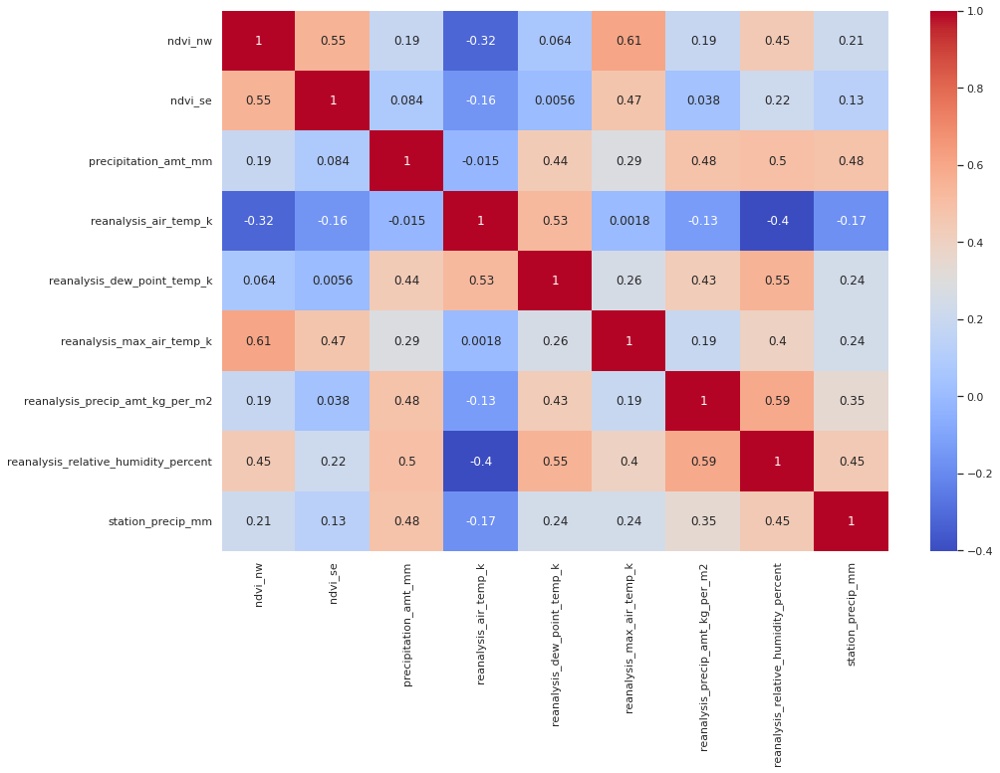

In [595]:
fig_dims = (15, 10)
fig, ax = plt.subplots(figsize=fig_dims)
g=sns.heatmap(corr,cmap='coolwarm',annot=True,ax=ax)
sns.set(font_scale=1)

## Estandarizacion de los datos

In [596]:
#Proceso de estandarizacion
scaler = StandardScaler()
np_standard = scaler.fit_transform(train) #numpy
train_standard = pd.DataFrame(np_standard,columns=train.columns,index=train.index)
train_standard.head()

ndvi_nw  ...  station_precip_mm
city weekofyear year            ...                   
sj   18         1990 -0.203670  ...          -0.489876
     19         1990  0.118034  ...          -0.646168
     20         1990  0.375662  ...           0.046589
     21         1990  0.978910  ...          -0.743323
     22         1990  1.122261  ...          -0.705306

[5 rows x 9 columns]

In [597]:
train_standard.describe()

,ndvi_nw,ndvi_se,precipitation_amt_mm,reanalysis_air_temp_k,reanalysis_dew_point_temp_k,reanalysis_max_air_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,station_precip_mm
count,1.456000e+03,1.456000e+03,1.456000e+03,1.456000e+03,1.456000e+03,1.456000e+03,1.456000e+03,1.456000e+03,1.456000e+03
mean,3.798091e-16,-7.228650e-17,-1.358384e-15,-2.423657e-14,-2.564798e-15,-1.160671e-14,-7.668050e-17,3.900268e-16,-4.495031e-17
std,1.000344e+00,1.000344e+00,1.000344e+00,1.000344e+00,1.000344e+00,1.000344e+00,1.000344e+00,1.000344e+00,1.000344e+00
min,-4.887624e+00,-2.932614e+00,-1.043932e+00,-2.983696e+00,-3.669011e+00,-1.738751e+00,-9.260600e-01,-3.406980e+00,-8.278060e-01
25%,-6.678197e-01,-6.696513e-01,-8.233184e-01,-7.663133e-01,-7.372632e-01,-7.486279e-01,-6.239658e-01,-6.971361e-01,-6.440564e-01
50%,-1.015853e-01,-9.332271e-02,-1.702744e-01,-3.785322e-02,2.579173e-01,-3.154489e-01,-2.970529e-01,-2.618928e-01,-3.251346e-01
75%,7.141991e-01,6.030168e-01,5.607441e-01,8.296360e-01,7.953849e-01,6.437333e-01,2.790849e-01,5.909328e-01,3.058446e-01
max,2.730603e+00,4.513185e+00,7.881154e+00,2.572222e+00,2.098592e+00,3.273749e+00,1.224511e+01,2.295686e+00,1.064704e+01


A continuación, analizamos la distribución de los valores con boxplot y pares de variables

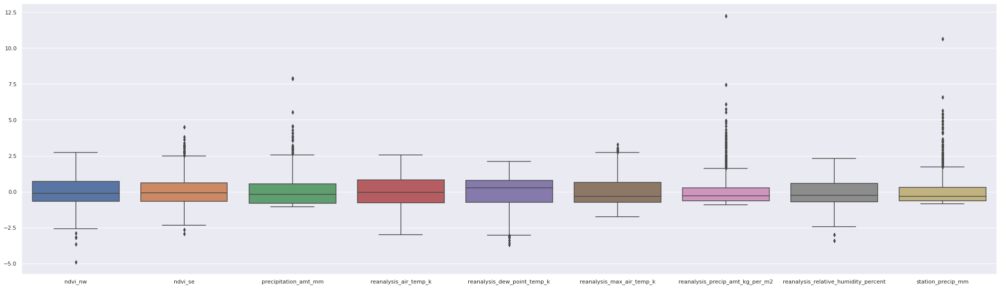

In [598]:
 fig_dims = (35, 10)
 fig, ax = plt.subplots(figsize=fig_dims)
 g=sns.boxplot(data=train_standard,ax=ax)


Se observa que existen varias variables con muchos puntos que se consideran "Outliers" en base a los valores de sí misma. 

En este ejercicio, dado que no estamos trabajando con una regresión ni problema supervisado y que nuestro conjunto de datos no es demasiado grande optaremos por eliminar los mínimos registros excepto en aquellos casos donde los registros parezcan outliers de los propios outliers (5 puntos-registros).

In [599]:
#Tomo algunas referencias para eliminar valores y los elimino
#print(train_standard['ndvi_nw'].min())
train_standard = train_standard[train_standard['ndvi_nw']>-4.5]
train_standard = train_standard[train_standard['precipitation_amt_mm']< 7.5]
train_standard = train_standard[train_standard['reanalysis_precip_amt_kg_per_m2']< 7.2]
train_standard = train_standard[train_standard['station_precip_mm']<7.5]

Además de este estudio dado que estamos tratando de situaciones climatológicas, tendremos que realizar un análisis más exhaustivo analizando por separado ambas regiones por lo que generamos un apartado para este estudio a continuación.

## Outliers - Análisis individualizado por región

Es necesario enfocar sobre cada región para un estudio más correcto de los outliers, ya que además que estamos tratando sobre dos regiones diferentes (con posibles subregiones internas), el dataset está ligeramente desbalanceado.

In [600]:
#Generamos df para las ciudades
sj = train_standard[train_standard.index.get_level_values(0)=='sj']
iq = train_standard[train_standard.index.get_level_values(0)=='iq']

In [601]:
print(sj.shape)
print(iq.shape)

(932, 9)
(518, 9)


Ya que nuestro dataset es pequeño y ya hemos eliminado cinco registros, tendremos que tener especial cuidado en cuántos registros eliminamos. 

Eliminaremos aquellos que presentan valores muy atípicos.

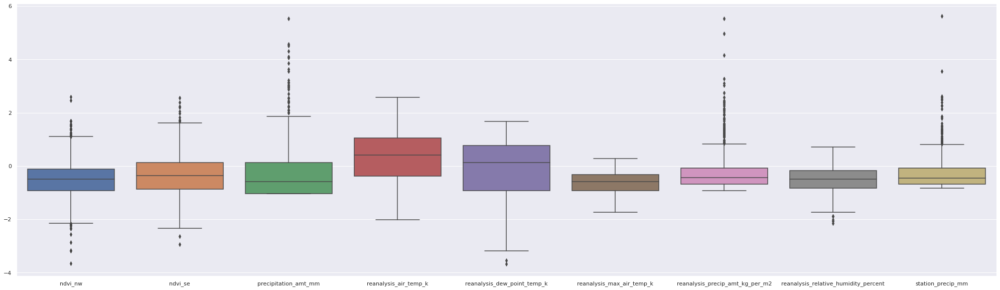

In [602]:
 fig_dims = (35, 10)
 fig, ax = plt.subplots(figsize=fig_dims)
 g=sns.boxplot(data=sj,ax=ax)

In [603]:
#Podriamos realizarlo en un paso uniendo en una condicion pero dividimos para facilitar el entendimiento del codigo y el testeo de result parciales
sj = sj[sj['ndvi_nw']<2]
sj = sj[sj['reanalysis_precip_amt_kg_per_m2']<4]
sj = sj[sj['station_precip_mm']<3.5]
sj = sj[sj['precipitation_amt_mm']<5]
sj = sj[sj['ndvi_nw']>sj['ndvi_nw'].min()]

In [604]:
sj.shape

(923, 9)

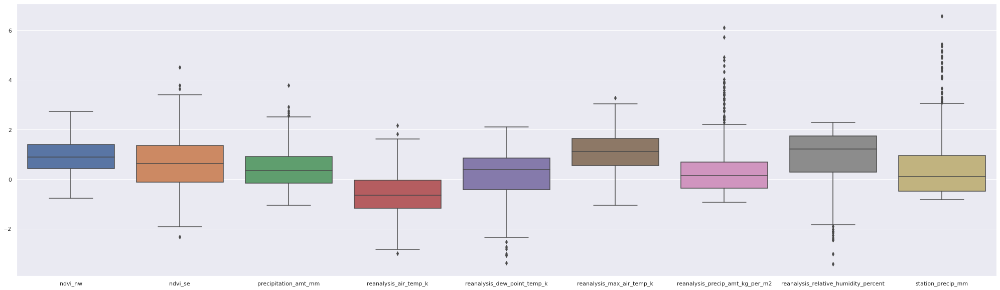

In [605]:
 fig_dims = (35, 10)
 fig, ax = plt.subplots(figsize=fig_dims)
 g=sns.boxplot(data=iq,ax=ax)

In [606]:
iq = iq[iq['ndvi_se']<4]
iq = iq[iq['station_precip_mm']<6]
iq = iq[iq['reanalysis_relative_humidity_percent']>-3]
iq = iq[iq['precipitation_amt_mm']<3.5]
iq = iq[iq['reanalysis_precip_amt_kg_per_m2']<5.2]

In [607]:
iq.shape

(511, 9)

In [608]:
train_standard = pd.concat([iq,sj])

El resumen es que se han eliminado un total de 21 registros de los 1461 iniciales, lo que supone un 

## Distribucion de los datos según la región

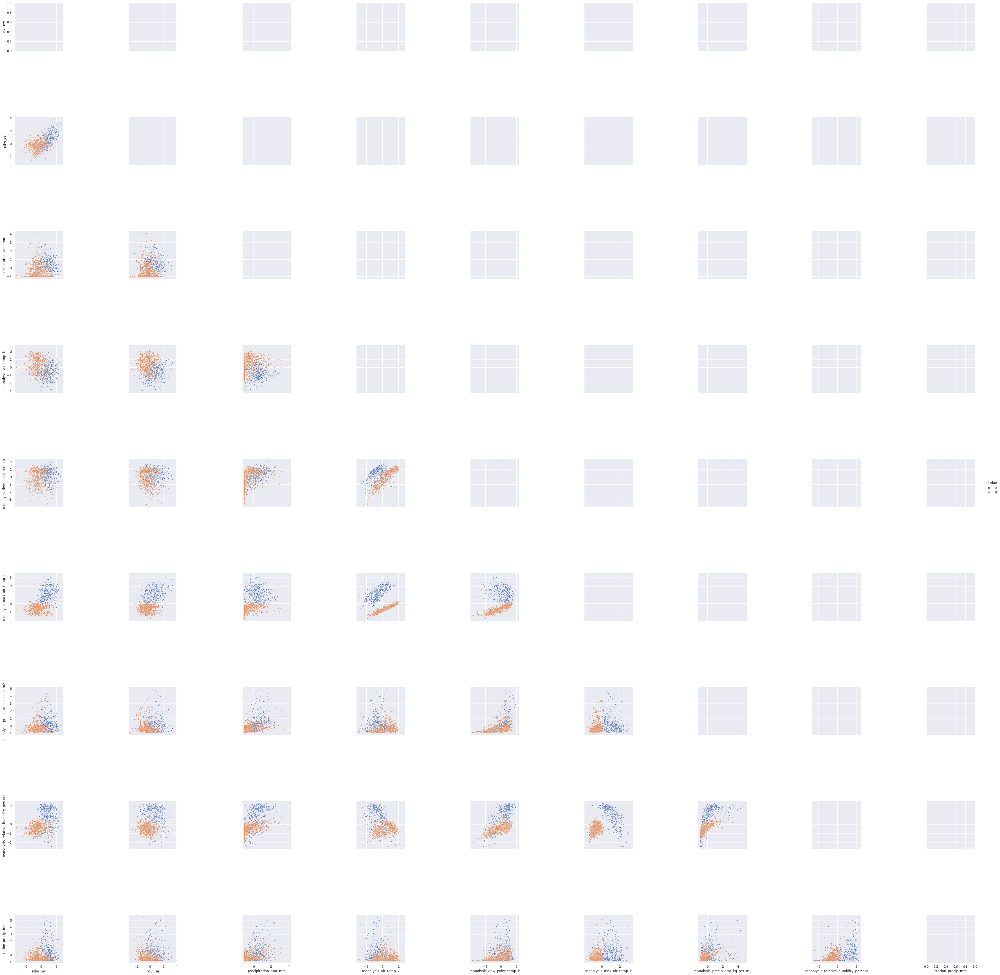

In [609]:
#Creamos una columna con nuestro valor de index ciudad
train_standard['Ciudad'] = train_standard.index.get_level_values(0)
#Graficamos unicamente la diagonal inferior para no repetir los mismos graficos con las variables invertidas
g = sns.PairGrid(train_standard,hue='Ciudad')
g.fig.set_size_inches(50,50)
g.map_lower(sns.scatterplot,s=5)
g.add_legend();


<font color='red'>IMPORTANTE: LOS SIGUIENTES GRÁFICOS SON GENERADOS UNICAMENTE EN COLAB - NO SE CONVIERTEN EN EL PDF</font>

###Analisis exhaustivo de los gráficos generados

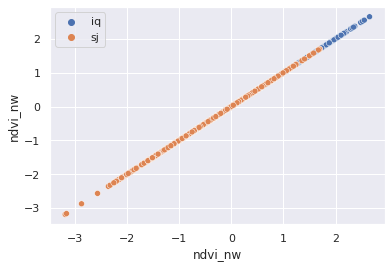

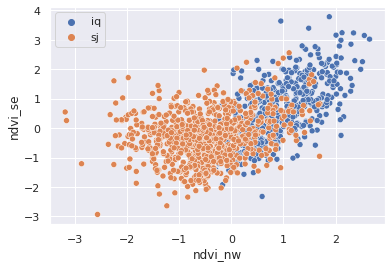

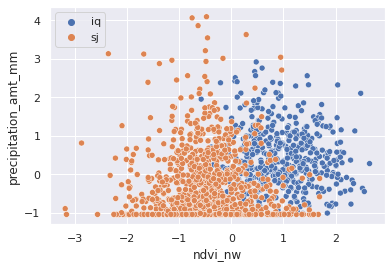

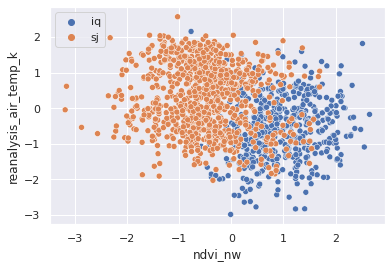

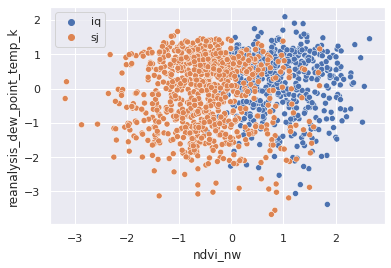

...

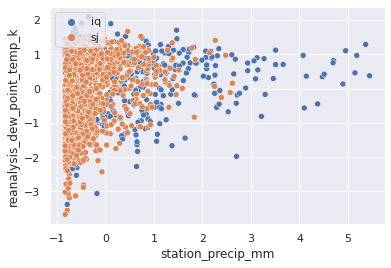

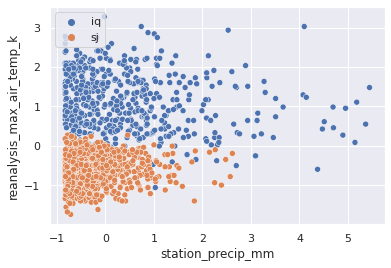

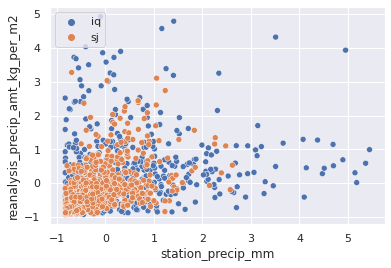

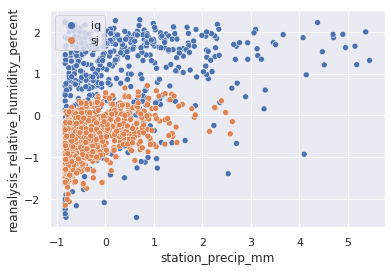

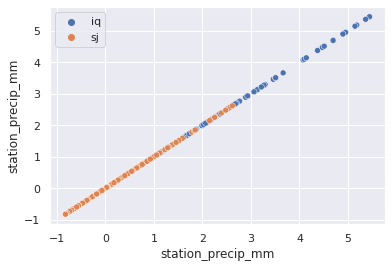

In [610]:
#Generamos los gráficos individualizados para mejor visualización
for i in range(0,9):
  for j in range(0,9):
    col_x = train_standard.columns[i]
    col_y = train_standard.columns[j]
    #Grafico cada par de columnas
    ax = sns.scatterplot(data=train_standard, x=train_standard[col_x], y=train_standard[col_y], hue="Ciudad")
    plt.legend(loc="upper left")#, markerscale=2,scatterpoints=1, fontsize=80)
    plt.show(ax)
    


En la mayoría de las comparaciones podemos observar claramente como se diferencian los valores para las dos regiones, lo que por tanto implica, que a nivel geográfico-climatológico existen diferencias entre estas regiones, sin embargo, estas regiones pueden tener en su interior otras subregiones o incluso que a nivel temporal existan más grupos.

Por este motivo realizaremos otros dos estudios:

\\
####1. ¿Existe dentro de las ciudades efecto temporal (Años)?
####2. ¿Puede que existan subregiones?
\\

####El objetivo de estos análisis es intentar conseguir hipótesis como científicos de datos que en principio tendrían sentido para posteriormente con la ayuda de métodos matemáticos como silhoutte realizar comparativas.

##¿Existe dentro de las regiones efecto temporal (Años)?

Para este análisis lo que vamos a realizar es una división de los años en intervalos de cinco años, generando cuatro grupos por cada región ya que el estudio presenta 20 años.

In [611]:
train_standard['Epoca'] = train_standard.index.get_level_values(2) - 1990
train_standard['Epoca'] = train_standard['Epoca']/5
train_standard['Epoca'] = train_standard['Epoca'].astype(int)
train_standard['Ciudad-Epoca'] = train_standard['Epoca'].astype(str) + "-" + train_standard['Ciudad']
train_standard.drop(columns=['Epoca','Ciudad'],inplace=True)

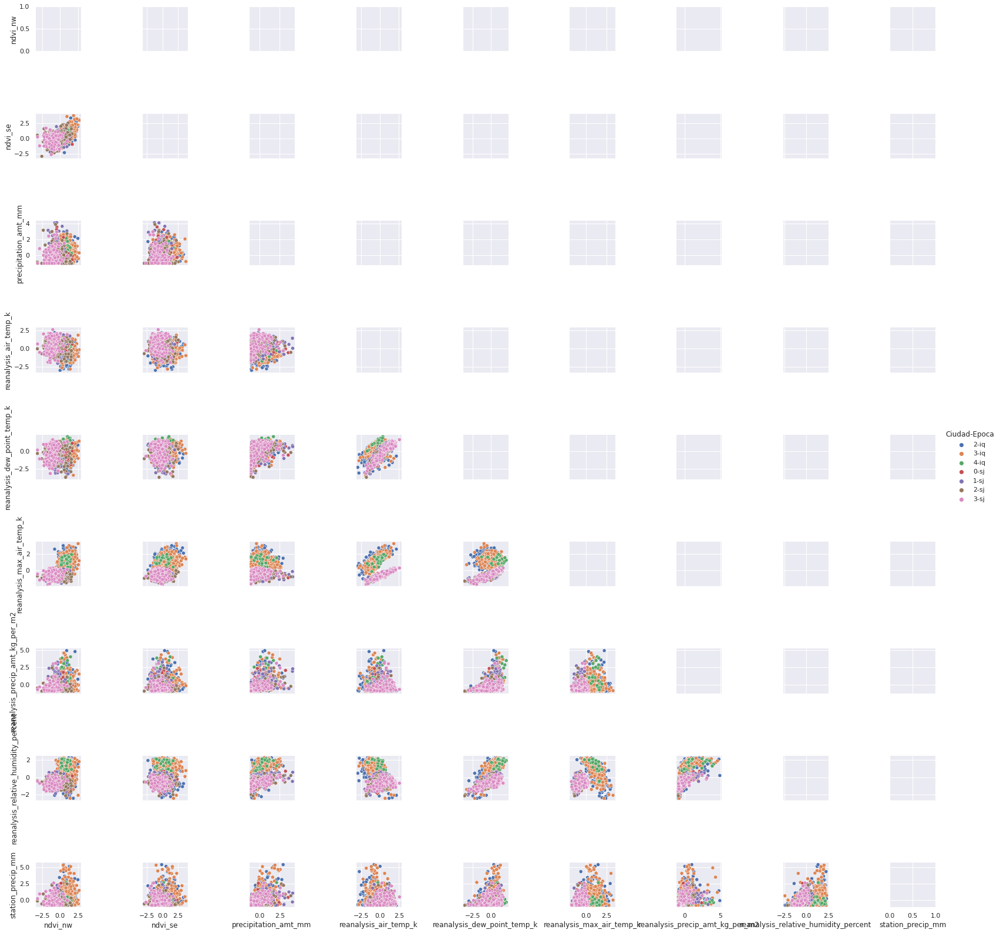

In [612]:
g = sns.PairGrid(train_standard,hue='Ciudad-Epoca',diag_sharey=False)
g.map_lower(sns.scatterplot)
g.add_legend();

<font color='red'>IMPORTANTE: LOS SIGUIENTES GRÁFICOS SON GENERADOS UNICAMENTE EN COLAB - NO SE CONVIERTEN EN EL PDF</font>

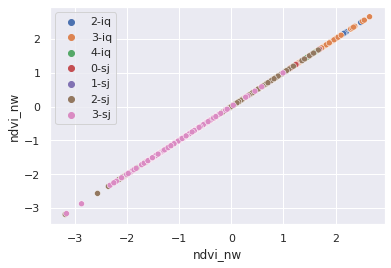

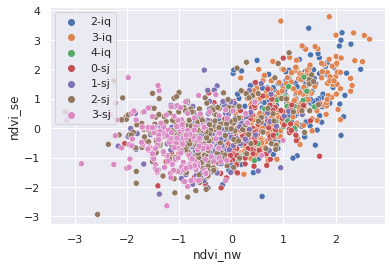

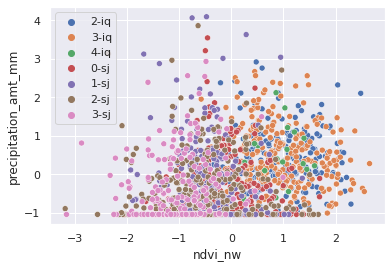

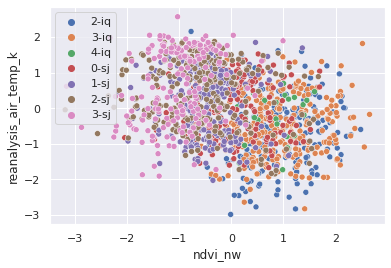

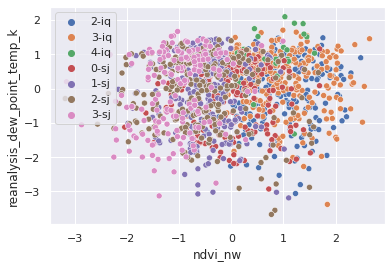

...

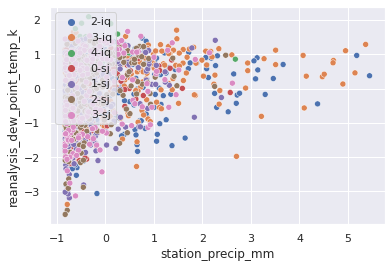

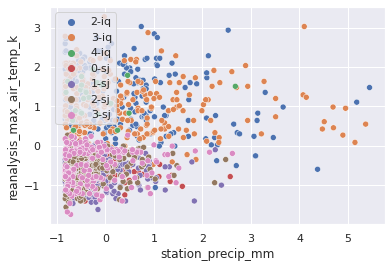

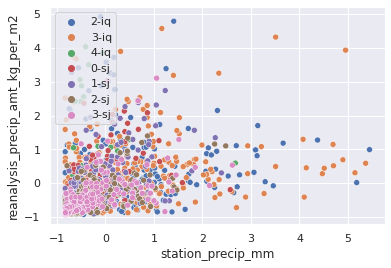

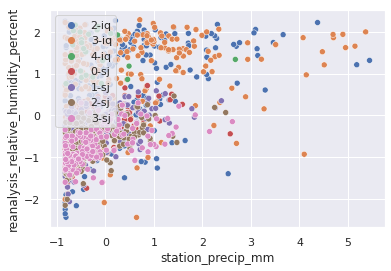

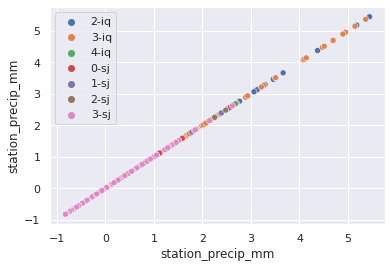

In [613]:
#Generamos los gráficos individualizados para mejor visualización
for i in range(0,9):
  for j in range(0,9):
    col_x = train_standard.columns[i]
    col_y = train_standard.columns[j]
    #Grafico cada par de columnas
    ax = sns.scatterplot(data=train_standard, x=train_standard[col_x], y=train_standard[col_y], hue="Ciudad-Epoca")
    plt.legend(loc="upper left")#, markerscale=2,scatterpoints=1, fontsize=80)
    plt.show(ax)

En base a los resultados, parece que el dataset no presenta agrupaciones/patrones claros en función del tiempo dentro de cada una de las regiones.

##¿Puede que existan variaciones por la existencia de subregiones?

Para este estudio, analizamos los valores de los pixeles que hacen referencia a las coordenadas ya que presentan variedad, y generamos dos divisiones internas para cada región, obteniendo cuatro grupos

In [614]:
#Generamos dos dataframes, uno para cada region
sj_loc = train_standard[train_standard.index.get_level_values(0)=='sj']
iq_loc = train_standard[train_standard.index.get_level_values(0)=='iq']

In [615]:
#A continuación analizamos la variedad de valores para las columnas referidas a los pixeles de localizacion
sj_loc.describe()

,ndvi_nw,ndvi_se,precipitation_amt_mm,reanalysis_air_temp_k,reanalysis_dew_point_temp_k,reanalysis_max_air_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,station_precip_mm
count,923.000000,923.000000,923.000000,923.000000,923.000000,923.000000,923.000000,923.000000,923.000000
mean,-0.509559,-0.350379,-0.278245,0.338378,-0.098322,-0.627712,-0.266288,-0.510573,-0.282145
std,0.733073,0.774218,0.891130,0.912597,1.030559,0.390317,0.625582,0.467102,0.560500
min,-3.186650,-2.932614,-1.043932,-2.026756,-3.669011,-1.738751,-0.926060,-2.156928,-0.827806
25%,-0.933048,-0.870949,-1.043932,-0.376769,-0.928347,-0.934276,-0.677874,-0.830443,-0.686298
50%,-0.500762,-0.355380,-0.582140,0.408614,0.126474,-0.593921,-0.441232,-0.494182,-0.462419
75%,-0.119166,0.125523,0.126657,1.053919,0.764980,-0.315449,-0.081073,-0.177678,-0.094920
max,1.695806,2.561342,4.094962,2.572222,1.670115,0.272437,3.275786,0.715958,2.616971


In [616]:
iq_loc.describe()

,ndvi_nw,ndvi_se,precipitation_amt_mm,reanalysis_air_temp_k,reanalysis_dew_point_temp_k,reanalysis_max_air_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,station_precip_mm
count,511.000000,511.000000,511.000000,511.000000,511.000000,511.000000,511.000000,511.000000,511.000000
mean,0.928934,0.638955,0.417516,-0.614287,0.168132,1.127412,0.365369,0.911650,0.442421
std,0.637933,1.032743,0.788818,0.856552,0.909342,0.734266,1.057804,1.031442,1.230936
min,-0.771485,-2.322088,-1.043932,-2.983696,-3.377123,-1.058042,-0.926060,-2.447090,-0.827806
25%,0.441453,-0.109358,-0.149710,-1.180515,-0.425495,0.550909,-0.367930,0.293686,-0.481427
50%,0.883567,0.641955,0.335275,-0.644860,0.385618,1.107854,0.135945,1.219451,0.101502
75%,1.388744,1.346985,0.913258,-0.037853,0.855259,1.633857,0.690035,1.727934,0.948440
max,2.651715,3.786837,2.919346,2.158807,2.098592,3.273749,4.921894,2.295686,5.442914


Dado que se consiguió unas separaciones de puntos visualmente bastante notables, profundizaremos dentro de esta división analizando si existen subregiones. Para ello, emplearemos el campo NW, y dividiremos ambos según su segundo cuartil que representa al 50% de valores.




In [617]:
train_standard['Ciudad'] = train_standard.index.get_level_values(0)
train_standard.drop(columns=['Ciudad-Epoca'],inplace=True)
train_standard.head()


ndvi_nw   ndvi_se  ...  station_precip_mm  Ciudad
city weekofyear year                      ...                           
iq   26         2000  0.035052  1.859001  ...          -0.764444      iq
     27         2000  1.238560  1.167607  ...           0.346502      iq
     28         2000  0.377017  0.020278  ...          -0.023109      iq
     29         2000  0.145256  0.693618  ...          -0.194187      iq
     30         2000  1.623673  0.695923  ...          -0.743323      iq

[5 rows x 10 columns]

In [618]:

def get_Region(row):
  region = None
  if row[9]=='sj':
    if row[0]<-0.5:
        region=1
    else:
        region=2
  else:
    if row[0]<0.635:
        region=3
    else:
        region=4

  return region
    
train_standard['Region']=train_standard.apply(lambda row: get_Region(row), axis=1)

In [619]:
train_standard.head()
train_standard['Region'].value_counts()

1    463
2    460
4    318
3    193
Name: Region, dtype: int64

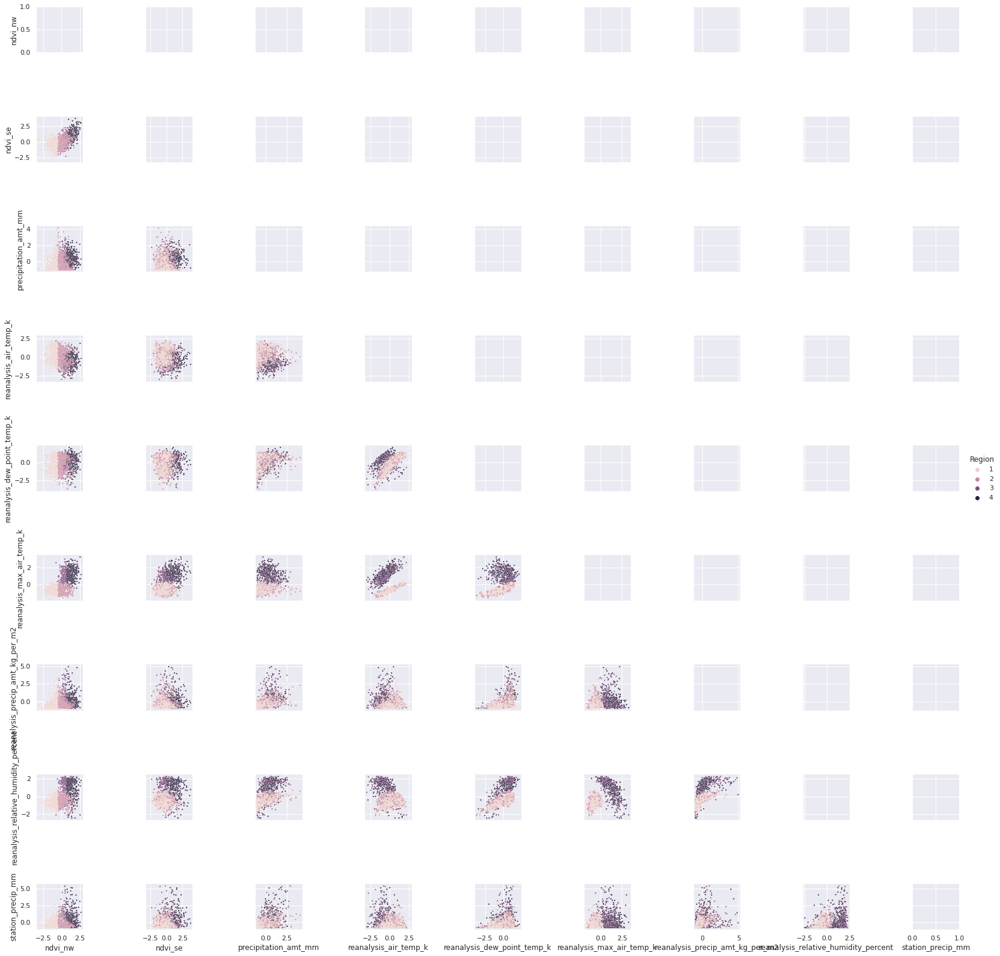

In [620]:
g = sns.PairGrid(train_standard,hue='Region')
g.map_lower(sns.scatterplot,s=5)
g.add_legend();

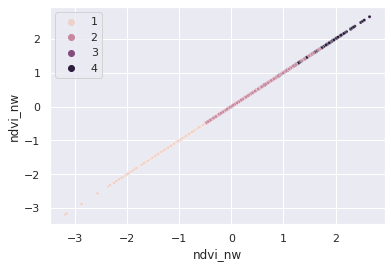

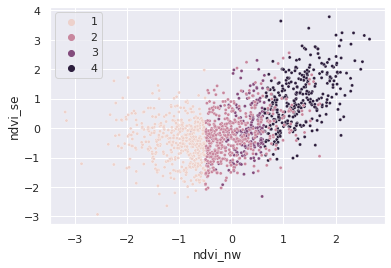

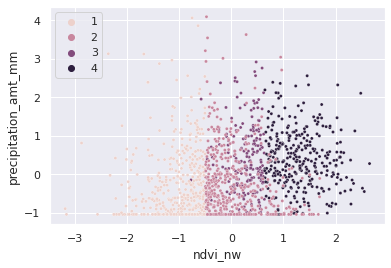

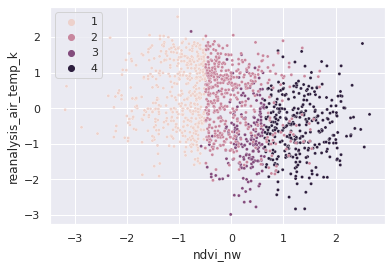

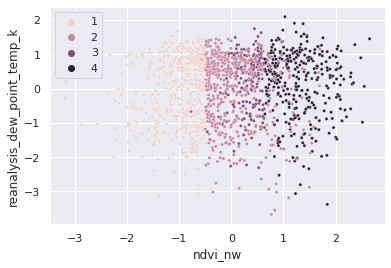

...

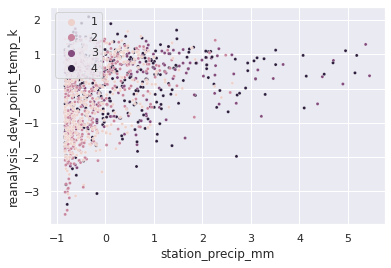

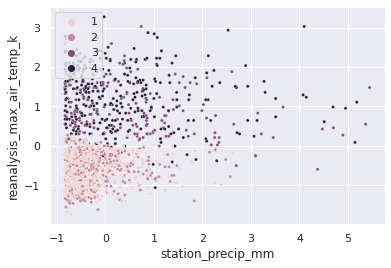

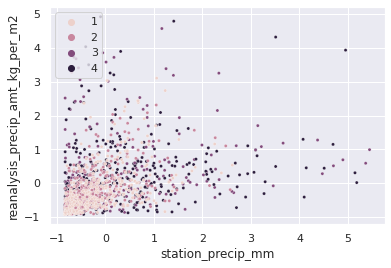

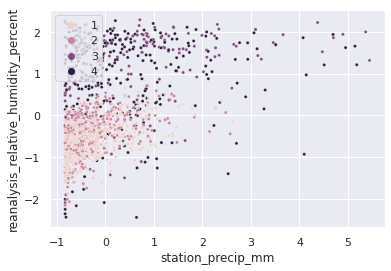

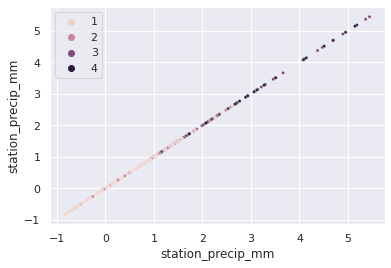

In [621]:
#Generamos los gráficos individualizados para mejor visualización
for i in range(0,9):
  for j in range(0,9):
    col_x = train_standard.columns[i]
    col_y = train_standard.columns[j]
    #Grafico cada par de columnas
    ax = sns.scatterplot(data=train_standard, x=train_standard[col_x], y=train_standard[col_y], hue="Region",s=10)
    plt.legend(loc="upper left")#, markerscale=2,scatterpoints=1, fontsize=80)
    plt.show(ax)

Existe disparidad, ya que existen gráficos donde esta división generada presenta una clusterización donde los puntos de las subregiones no se mezclan pero en otros gráficos si ocurre dicha mezcla.

Por tanto, no descartamos la opción de 4 subdivisiones.

## Balanceo del dataset y estandarización

In [622]:
#Eliminamos de los dataset divididos en regiones la única columna no numérica
#Tomamos los valores del dataset inicial TRAIN, ya que tomaremos valores aleatorios
#y puede que el proceso de estandarización realizado sea incorrecto con estas inserciones

df_iq = train[train.index.get_level_values(0)=='iq']
df_sj = train[train.index.get_level_values(0)=='sj']



In [623]:
df_balanceo = df_iq.sample(200)*0.01
df = pd.concat([df_balanceo,df_iq])
df = pd.concat([df,df_sj])

In [624]:
df.describe()

,ndvi_nw,ndvi_se,precipitation_amt_mm,reanalysis_air_temp_k,reanalysis_dew_point_temp_k,reanalysis_max_air_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,station_precip_mm
count,1656.000000,1656.000000,1656.000000,1656.000000,1656.000000,1656.000000,1656.000000,1656.000000,1656.000000
mean,0.112887,0.178439,40.248732,262.982962,259.944674,267.145268,35.338590,72.359226,34.531085
std,0.119357,0.095511,43.594249,96.401915,95.286225,97.949730,42.620678,27.333194,46.158675
min,-0.456100,-0.015533,0.000000,2.948500,2.900886,3.019000,0.000000,0.577871,0.000000
25%,0.011137,0.127011,0.992075,297.243571,293.442857,300.300000,8.300000,75.529286,4.250000
50%,0.093000,0.184271,30.175000,298.353571,295.277143,302.100000,23.190000,79.392857,18.600000
75%,0.196836,0.237461,64.617500,299.639286,296.381786,304.800000,46.900000,84.473214,47.500000
max,0.454429,0.538314,390.600000,302.200000,298.450000,314.000000,570.500000,98.610000,543.300000


In [625]:
df.shape

(1656, 9)

In [626]:
scaler = StandardScaler()
np_balanced_st = scaler.fit_transform(df)
df_balanced_st = pd.DataFrame(np_balanced_st,columns=df.columns,index=df.index)
df_balanced_st.head()

ndvi_nw  ...  station_precip_mm
city weekofyear year            ...                   
iq   52         2002 -0.934643  ...          -0.718437
     25         2007 -0.935952  ...          -0.721016
     41         2000 -0.934852  ...          -0.747671
     11         2004 -0.928139  ...          -0.743099
     46         2009 -0.914232  ...          -0.729207

[5 rows x 9 columns]

Despues de realizar este balanceo, analizamos de nuevo el dataset al menos por regiones de forma genérica.

## Distribución de los datos según la region con dataset balanceado

Aplicamos análisis del dataset balanceado para ver el efecto de nuestro balanceo comparado con el análisis sin balanceo.

In [627]:
df_balanced_st['Ciudad'] = df_balanced_st.index.get_level_values(0)

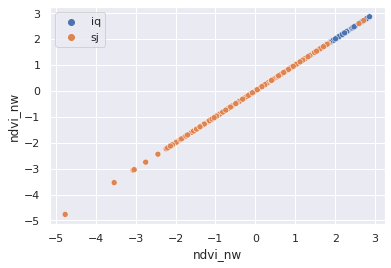

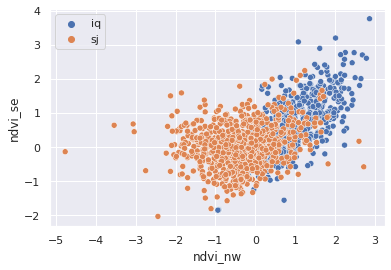

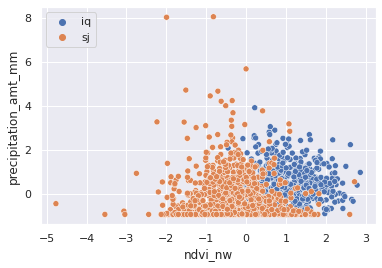

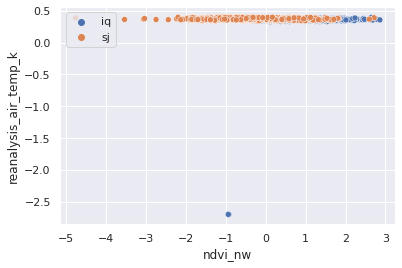

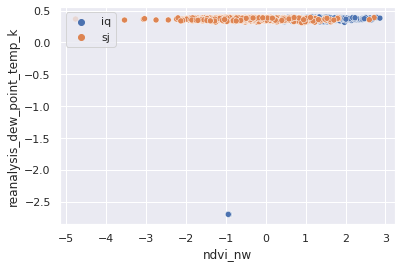

...

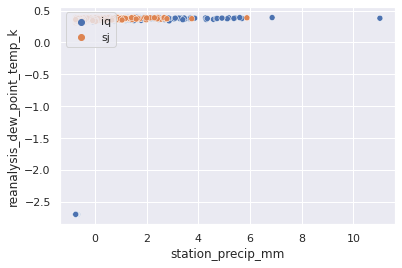

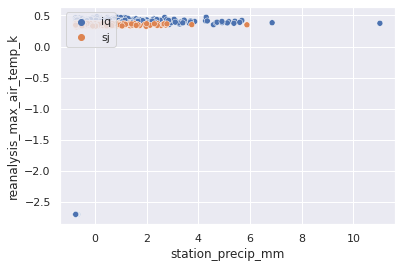

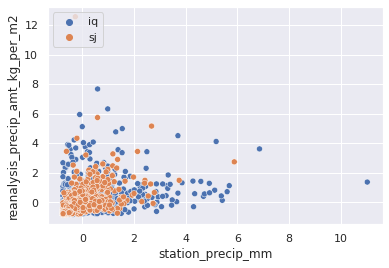

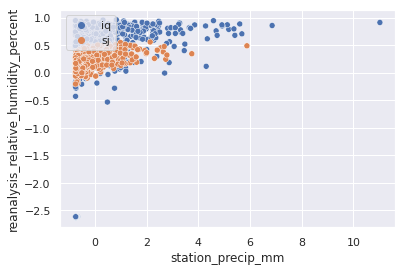

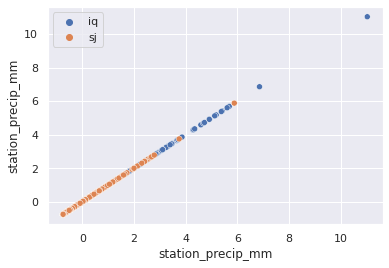

In [628]:
#Generamos los gráficos individualizados para mejor visualización
for i in range(0,9):
  for j in range(0,9):
    col_x = df_balanced_st.columns[i]
    col_y = df_balanced_st.columns[j]
    #Grafico cada par de columnas
    ax = sns.scatterplot(data=df_balanced_st, x=df_balanced_st[col_x], y=df_balanced_st[col_y], hue="Ciudad")
    plt.legend(loc="upper left")
    plt.show(ax)

## Reducción de dimensionalidad (PCA - T-SNE)

A pesar de haber realizado una reducción de dimensionalidad del dataset original en base a parámetros matemáticos como la correlación, es importante realizar una reducción mayor de dimensionalidad que facilite la graficación en dos dimensiones de la clusterización.

Para ello emplearemos PCA, que realizará combinaciones lineales de las variables intentando mantener la máxima varianza posible.

In [629]:
from sklearn.decomposition import PCA
#Antes de aplicarlo eliminamos la columna ciudad
df_copy = df_balanced_st # No quiero perder la columna ciudad ni el index
df_balanced_st.drop(columns=['Ciudad'],inplace=True)
pca = PCA(n_components = 2)
X_train = pca.fit_transform(df_balanced_st)

In [630]:
explained_variance = pca.explained_variance_ratio_
sum(explained_variance)

0.7513475491101012

Tomaremos como válido el número de variables necesarias para alcanzar al menos un 80% de varianza.

In [631]:
pca3 = PCA(n_components = 3)
X_train_3 = pca3.fit_transform(df_balanced_st)
explained_variance3 = pca3.explained_variance_ratio_
explained_variance3

array([0.58491151, 0.16643604, 0.10270318])

In [632]:
sum(explained_variance3)

0.854050729983786

Como vemos para conseguir el objetivo, necesitamos al menos 3 variables, sin embargo, para realizar las visualizaciones utilizaremos 2 dimensiones para facilitarlo.

De la realización de PCA, podemos concluir que no es muy erróneo pasar a un espacio de 2-3 dimensiones, por este motivo emplearemos un enfoque un poco más complejo y potente: T-SNE.

In [633]:
from sklearn.manifold import TSNE
model = TSNE(n_components = 2, random_state = 0)
np_tsne_data = model.fit_transform(df_balanced_st)


In [634]:
df_copy['Ciudad'] = df_copy.index.get_level_values(0)
df_copy['Region']=df_copy.apply(lambda row: get_Region(row), axis=1)

In [635]:
tsne_df_ciudad = pd.DataFrame(data = np_tsne_data,index=df_copy['Ciudad'])
tsne_df_ciudad['Ciudad'] = tsne_df_ciudad.index.get_level_values(0)
tsne_df_region = pd.DataFrame(data = np_tsne_data,index=df_copy['Region'])
tsne_df_region['Region'] = tsne_df_region.index.get_level_values(0)

In [636]:
tsne_df_region.head()

,0,1,Region
Region,,,
3,44.740215,52.094646,3
3,41.907894,52.015324,3
3,22.936842,51.320000,3
3,32.865715,55.921860,3
3,30.707029,60.581299,3


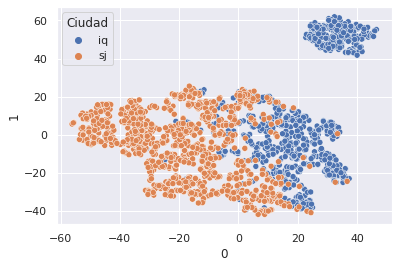

In [637]:

g = sns.scatterplot(data=tsne_df_ciudad, x=0,y=1,hue='Ciudad')

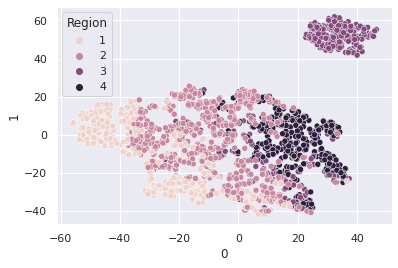

In [638]:
g = sns.scatterplot(data=tsne_df_region, x=0,y=1,hue='Region')

En base a los resultados obtenidos, parece que la división en 4 grupos parece conseguir unos resultados muy favorables.

#CREACIÓN DE MODELOS NO SUPERVISADOS

Con los análisis anteriores, conseguimos obtener una idea de cuántas agrupaciones podrían ser adecuadas. Un rango de 2-5 parece que puede ser un buen enfoque en base a los resultados obtenidos.

Para los apartados anteriores, empleamos la región "sj" e "iq" proporcionadas por el problema/dataset, así, como subregiones creadas en base a datos estadísticos. Sin embargo, también dejaremos que sean los propios métodos de clusterización los que nos ayuden a generar los grupos existentes, juzgando los resultados con las hipotesis generadas en la fase de preprocesado.

In [639]:
tsne_df= pd.DataFrame(data = np_tsne_data)
np_x = tsne_df.iloc[:,0].to_numpy()
np_y = tsne_df.iloc[:,1].to_numpy()

Ya que realmente no conocemos el número exacto de clusters, solo tenemos una idea realizamos métodos que puedan ayudarnos con la elección

In [640]:
from sklearn import metrics

distortions = []
silhouettes = []

for i in range(2, 20):
    km = KMeans(i, init='random', n_init=10, max_iter=300, tol=1e-4, random_state=42)
    clustering = km.fit_predict(tsne_data)
    distortions.append(km.inertia_)
    silhouettes.append(metrics.silhouette_score(tsne_df, clustering))

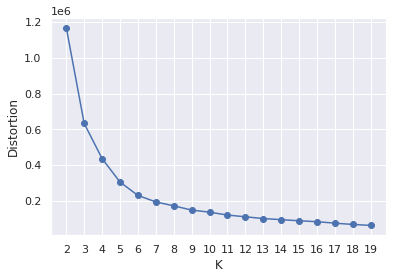

In [641]:
plt.plot(range(2,20), distortions, marker='o')
plt.xticks(range(2, 20))
plt.xlabel('K')
plt.ylabel('Distortion')
plt.grid(True)
plt.show()

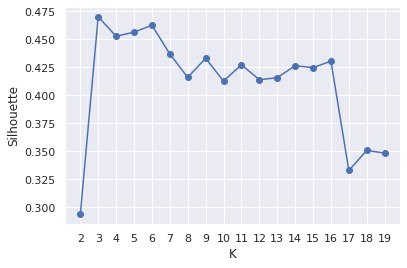

In [642]:
plt.plot(range(2,20), silhouettes , marker='o')
plt.xticks(range(2, 20))
plt.xlabel('K')
plt.ylabel('Silhouette')
plt.grid(True)
plt.show()

Empleando el método de silhoutte podemos observar que en principio, el valor óptimo matemáticamente es K=3.

## Enfoque basado en particiones

In [643]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

In [644]:
kmeans = KMeans(n_clusters=4,random_state=0)
clusters = kmeans.fit_predict(tsne_df)
#kmeans.cluster_centers_.shape

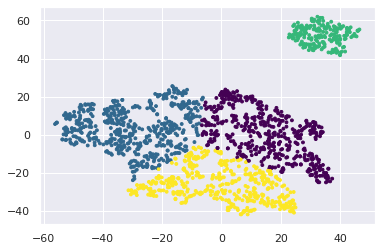

In [645]:
plt.scatter(x=np_x, y=np_y, c=clusters,s=8, cmap='viridis')

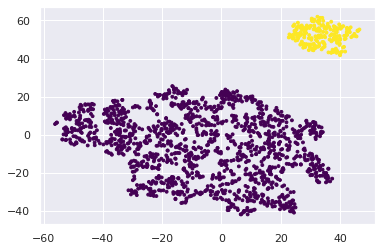

In [646]:
kmeans = KMeans(n_clusters=2,random_state=0)
clusters = kmeans.fit_predict(tsne_df)
plt.scatter(x=np_x, y=np_y, c=clusters,s=8, cmap='viridis')

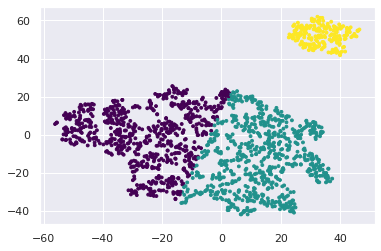

In [647]:
kmeans = KMeans(n_clusters=3,random_state=0)
clusters = kmeans.fit_predict(tsne_df)
plt.scatter(x=np_x, y=np_y, c=clusters,s=8, cmap='viridis')

El enfoque conseguido con 3 clusters, se considera el resultado más óptimo ya que es capaz prácticamente de realizar la separación completa en el conglomerado superior entre las dos ciudades-regiones conocidas, y además, asigna un cluster individual para el conglomerado inferior que parece bastante claro que pertenece a un grupo a parte.



## Enfoque basado en densidades

Probaremos una técnica por densidad, sin embargo, no parece que este método sea un buen enfoque, ya que inicialmente no parece sea un conjunto de datos clasificado por densidad si no por posición de los registros.

In [648]:
from sklearn.cluster import DBSCAN

In [649]:
dbscan = DBSCAN(eps=3, min_samples=10)
clusters = dbscan.fit_predict(tsne_df)

In [650]:
dbscan.labels_

array([ 0,  0,  0, ..., 11, 11, 11])

No handles with labels found to put in legend.


Text(0, 0.5, 'Feature 1')

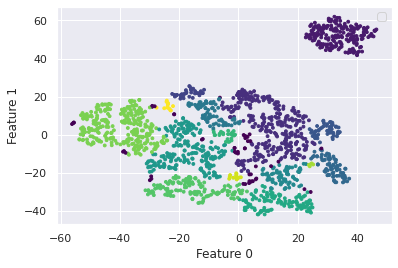

In [651]:
plt.scatter(np_x, np_y, c=clusters,s=8,cmap='viridis')
plt.legend()
plt.xlabel("Feature 0")
plt.ylabel("Feature 1")

Vamos a intentar buscar un método para conseguir un valor óptimo de epsilon o radio.

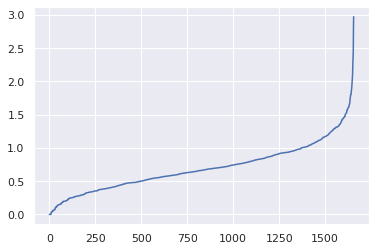

In [652]:
from sklearn.neighbors import NearestNeighbors
neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(tsne_df)
distances, indices = nbrs.kneighbors(tsne_df)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [653]:
#Entrenamos el modelo empleando 1.5
dbscan = DBSCAN(eps=1.5, min_samples=3)
clusters = dbscan.fit_predict(tsne_df)
dbscan.labels_

array([  0,   1,   2, ...,  99, 102,  44])

No handles with labels found to put in legend.


Text(0, 0.5, 'Feature 1')

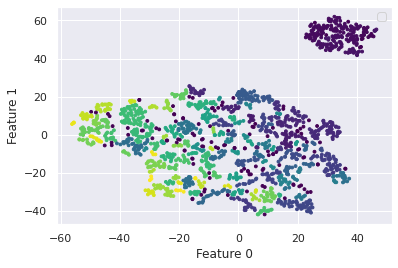

In [654]:
plt.scatter(np_x, np_y, c=clusters,s=8,cmap='viridis')
plt.legend()
plt.xlabel("Feature 0")
plt.ylabel("Feature 1")

Tras probar numerosas combinaciones se confirma la hipótesis inicial con el método DBSCAN.

## Enfoque basado en gaussianas

El resultado obtenido por el K-Means para K=3, parece un resultado bastante razonable. Sin embargo, por su conocida simplicidad y tendencia a agrupar con únicamente búsqueda circular, emplearemos un enfoque cuya idea general es similar pero más potentente como Gaussian Mixture.

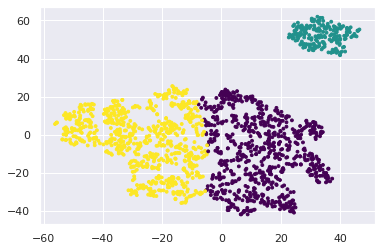

In [655]:
from sklearn import mixture

model = mixture.GaussianMixture(n_components=3, covariance_type='full',random_state=0)
labels = model.fit_predict(tsne_df)
plt.scatter(np_x, np_y, c=labels, s=8, cmap='viridis');


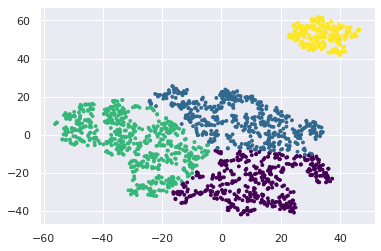

In [656]:
from sklearn import mixture

model = mixture.GaussianMixture(n_components=4, covariance_type='full',random_state=0)
labels = model.fit_predict(tsne_df)
plt.scatter(np_x, np_y, c=labels, s=8, cmap='viridis');

Este resultado empleando 4 componentes es el más reproducible independientemente de la semilla. No obstante existen resultados como el siguiente con semilla = 100, que parece visualmente bastante aceptable.

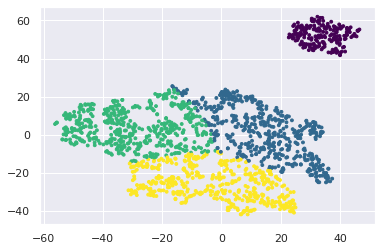

In [657]:
from sklearn import mixture

model = mixture.GaussianMixture(n_components=4, covariance_type='full',random_state=100)
labels = model.fit_predict(tsne_df)
plt.scatter(np_x, np_y, c=labels, s=8, cmap='viridis');

Emplearemos el resultado de K=5 obtenido con el método "Elbow method"

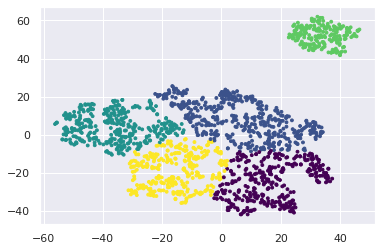

In [658]:
from sklearn import mixture

model = mixture.GaussianMixture(n_components=5, covariance_type='full',random_state=0)
labels = model.fit_predict(tsne_df)
plt.scatter(np_x, np_y, c=labels, s=8, cmap='viridis');

Este último resultado también parece conseguir un enfoque bastante acertado, si se compara en este caso, con las imagenes obtenidas en la fase de preprocesado cuando dividimos en 4 subregiones

No se realizará evaluación del modelo, ya que para los resultados más favorables K=3 y K=5 con GMM, no tenemos etiquetas-labels para evaluarlas.

#CONCLUSIONES

En la presente práctica se ha realizado un profundo análisis de un conjunto de datos perteneciente a las situaciones climatológicas en el tiempo de dos regiones. 

Para ello, se ha realizado una primera fase de inspección y preprocesado, eliminando aquellos datos que no aportan valor o que se consideran "outliers" con respecto a los valores típicos del dataset. 

Por otro lado, se ha realiza una clusterización con diferentes técnicas y enfoques en los que se inició con unas hipótesis. Estas hipótesis indicaban que el rango de 2 a 4 parecía el mejor para dividir nuestro conjunto de datos, sin embargo, métodos como silhouette y elbow nos permitieron afinar para finalmente concluir que K=3 parece la mejor división sin descartar la opcion de K=5.

Como resumen final, afirmamos que en base a los estudios realizados sobre el dataset, el mejor resultado se obtiene con el modelo de GMM empleando 3 componentes presentado en el apartado anterior dentro de "Enfoque basado en gaussianas".

#GENERACIÓN DE PDF 

In [659]:
!wget -nc https://raw.githubusercontent.com/brpy/colab-pdf/master/colab_pdf.py
from colab_pdf import colab_pdf
colab_pdf('P1-MachineLearning.ipynb')

--2021-11-11 14:26:20--  https://raw.githubusercontent.com/brpy/colab-pdf/master/colab_pdf.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.109.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1864 (1.8K) [text/plain]
Saving to: ‘colab_pdf.py’

colab_pdf.py        100%[===================>]   1.82K  --.-KB/s    in 0s      

2021-11-11 14:26:20 (31.1 MB/s) - ‘colab_pdf.py’ saved [1864/1864]





Extracting templates from packages: 100%
[NbConvertApp] Converting notebook /content/drive/MyDrive/Colab Notebooks/P1-MachineLearning.ipynb to pdf
[NbConvertApp] Support files will be in P1-MachineLearning_files/
[NbConvertApp] Making directory ./P1-MachineLearning_files
[NbConvertApp] Making directory ./P1-MachineLearning_files
[NbConvertApp] Making directory ./P1-MachineLearning_files
[NbConvertApp] Making directory

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

'File ready to be Downloaded and Saved to Drive'